In [1]:
# Lecture-08 Recurrent Neural Networks

In [1]:
import pandas as pd

In [2]:
# Loading data

In [3]:
timeserise_revenue = pd.read_csv('~/data/course_data/time_serise_revenue.csv')
sales_data = pd.read_csv('~/data/course_data/time_serise_sale.csv')
timeserise_revenue.head()

,Unnamed: 0,day_1,day_2,day_3,day_4,day_5,day_6,day_7,day_8,day_9,...,day_51,day_52,day_53,day_54,day_55,day_56,day_57,day_58,day_59,day_60
0,0,2.622866,2.657832,2.771121,2.815845,2.876267,2.859229,2.844758,2.793797,2.736443,...,1.228701,1.290414,1.474886,1.563295,1.736197,1.797285,1.978940,2.198979,2.277908,2.403300
1,1,2.057578,2.089561,2.138827,2.189964,2.224312,2.213340,2.197103,2.079228,2.072745,...,1.880965,1.869619,1.872043,1.854963,1.846967,1.878265,1.868918,1.877923,1.975341,1.959734
2,2,2.485055,2.349254,2.284784,2.142335,2.048803,1.990668,1.965783,1.866983,1.816916,...,2.714773,2.792819,2.788505,2.879778,2.873212,2.854421,2.863193,2.773218,2.708913,2.590657
3,3,2.053928,2.121919,2.148003,2.179574,2.161062,2.124168,2.153791,2.097816,1.953759,...,1.861072,1.875642,1.782617,1.768666,1.876252,1.815870,1.870878,1.923176,2.025993,2.048272
4,4,1.702631,1.825995,2.038047,2.194083,2.313903,2.417883,2.567613,2.650782,2.729691,...,1.258760,1.137150,1.109007,1.104999,1.150137,1.204513,1.221350,1.327023,1.387304,1.557363


In [4]:
def sample_from_table(sample_size, dataframe):
    sample_row = dataframe.sample().values[0]

    begin_column = random.randint(0, len(sample_row) - sample_size - 1)

    return (sample_row[begin_column: begin_column + sample_size],
            sample_row[begin_column + 1: begin_column + sample_size + 1])

In [5]:
import torch
import torch.nn as nn
from torch.nn import functional as F
from torch.autograd import Variable
from torch import optim
import numpy as np
import math, random
import matplotlib.pyplot as plt
import seaborn as sns
# Generating a noisy multi-sin wave

In [6]:
class FullyConnected(nn.Module):
    def __init__(self, x_size, hidden_size, output_size):
        super(FullyConnected, self).__init__()
        self.hidden_size = hidden_size

        self.linear_with_tanh = nn.Sequential(
            nn.Linear(10, self.hidden_size),
            nn.Tanh(),
            nn.Linear(self.hidden_size, self.hidden_size),
            nn.Tanh(),
            nn.Linear(self.hidden_size, output_size)
        )
    def forward(self, x):
        yhat = self.linear_with_tanh(x)
        return yhat

In [7]:
class SimpleRNN(nn.Module):
    def __init__(self, x_size, hidden_size, n_layers, batch_size, output_size):
        super(SimpleRNN, self).__init__()
        self.hidden_size = hidden_size
        self.n_layers = n_layers
        self.batch_size = batch_size
        # self.inp = nn.Linear(1, hidden_size)
        self.rnn = nn.RNN(x_size, hidden_size, n_layers, batch_first=True)
        self.out = nn.Linear(hidden_size, output_size) # 10 in and 10 out

    def forward(self, inputs, hidden=None):
        hidden = self.__init__hidden()
        # print('Forward hidden {}'.format(hidden.shape))
        # print('Forward inps {}'.format(inputs.shape))
        output, hidden = self.rnn(inputs.float(), hidden.float())
        # print('Out1 {}'.format(output.shape))
        output = self.out(output.float())
        # print('Forward outputs {}'.format(output.shape))

        return output, hidden
    
    def __init__hidden(self):
        hidden = torch.zeros(self.n_layers, self.batch_size, self.hidden_size, dtype = torch.float64)
        return hidden

In [8]:
# Set dataset

In [9]:
source_data = sales_data

In [10]:
# Fully Connected Model

In [11]:
n_epochs = 100
n_iters= 50
hidden_size = 2 # try to change this parameters
n_layers = 2
batch_size = 5
seq_length = 10
n_sample_size = 50

x_size = 1

In [12]:
fc_model = FullyConnected(x_size, hidden_size, output_size = seq_length)
fc_model = fc_model.double()

In [13]:
criterion = nn.MSELoss()
optimizer = optim.SGD(fc_model.parameters(), lr = 0.01)

losses = np.zeros(n_epochs)

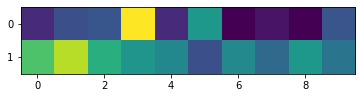

In [14]:
plt.imshow(fc_model.state_dict()['linear_with_tanh.0.weight'])
plt.show()

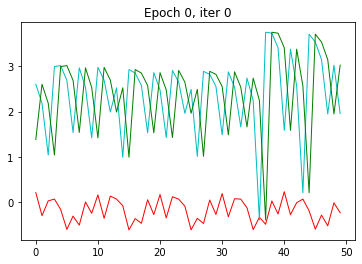

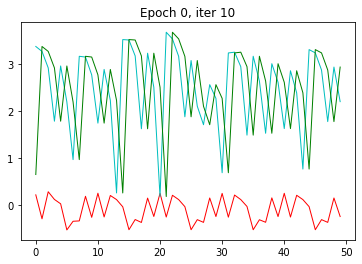

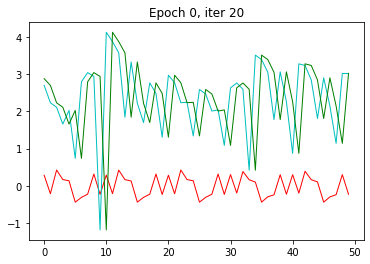

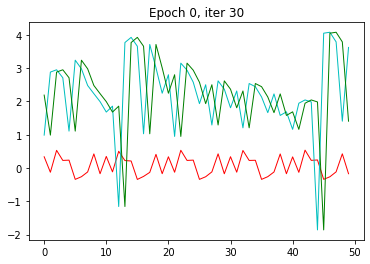

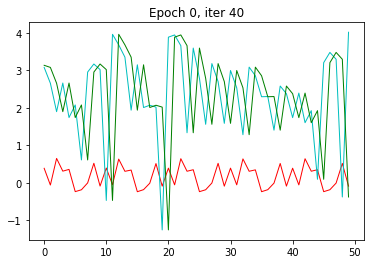

...

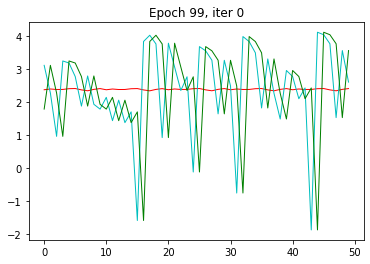

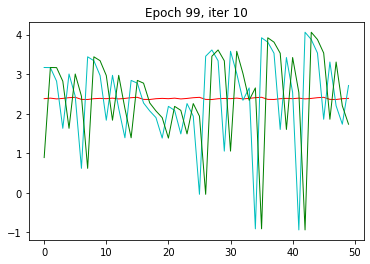

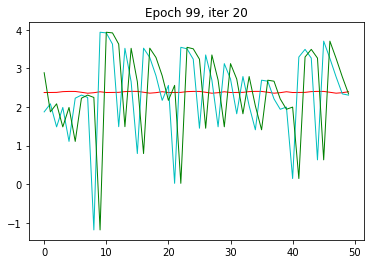

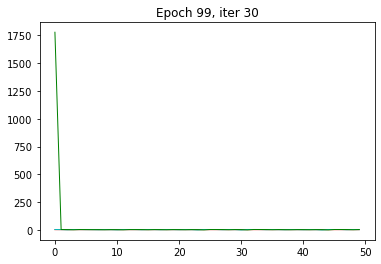

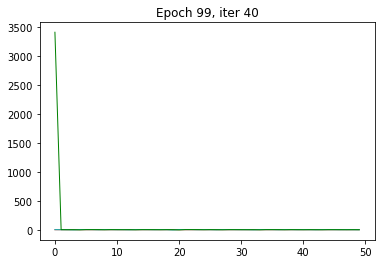

In [15]:
for epoch in range(n_epochs):
    for iter_ in range(n_iters):
        _inputs, _targets = sample_from_table(n_sample_size, source_data)

        inputs = Variable(torch.from_numpy(np.array([_inputs[0:10],
                                                    _inputs[10:20],
                                                    _inputs[20:30],
                                                    _inputs[30:40],
                                                    _inputs[40:50]],
                                                    dtype = np.double)))

        targets = Variable(torch.from_numpy(np.array([_targets[0:10],
                                                    _targets[10:20],
                                                    _targets[20:30],
                                                    _targets[30:40],
                                                    _targets[40:50]],
                                                    dtype = np.double)))
        
        outputs = fc_model(inputs.double())

        optimizer.zero_grad()
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()

        losses[epoch] += loss
        if iter_ % 10 == 0:
            plt.clf()
            plt.ion()
            plt.title('Epoch {}, iter {}'.format(epoch, iter_))
            plt.plot(torch.flatten(outputs.detach()), 'r-', linewidth = 1, label = 'Output')
            plt.plot(torch.flatten(targets), 'c-', linewidth = 1, label = 'Label')
            plt.plot(torch.flatten(inputs), 'g-', linewidth = 1, label = 'Input')
            plt.draw()
            plt.pause(0.05)

# RNN Model

In [16]:
n_epochs = 100
n_iters = 50
hidden_size = 2 # try to change this parameters
n_layers = 2
batch_size = 5
seq_length = 10
n_sample_size = 50

x_size = 1
output_size = 1

In [17]:
rnn_model = SimpleRNN(x_size, hidden_size, n_layers, int(n_sample_size / seq_length), output_size)

In [18]:
criterion = nn.MSELoss()
optimizer = optim.SGD(rnn_model.parameters(), lr = 0.01)

losses = np.zeros(n_epochs)

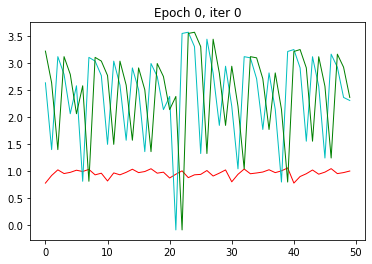

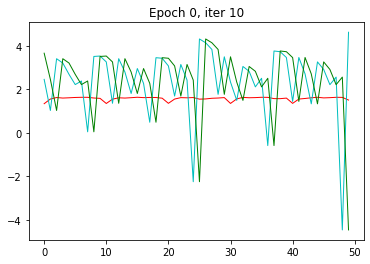

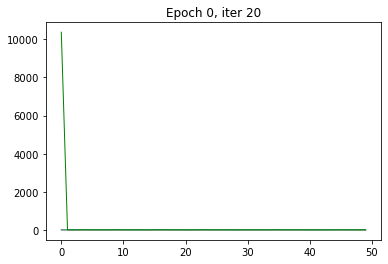

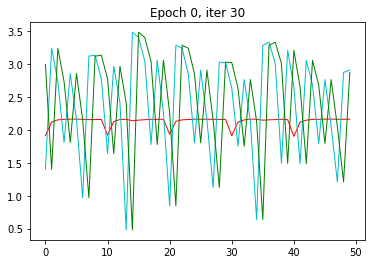

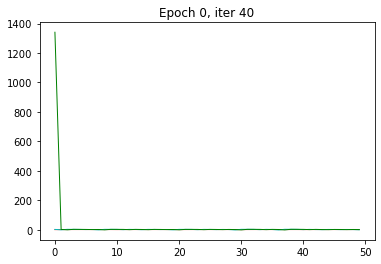

...

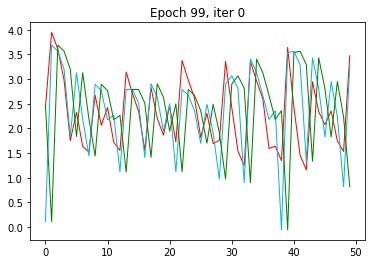

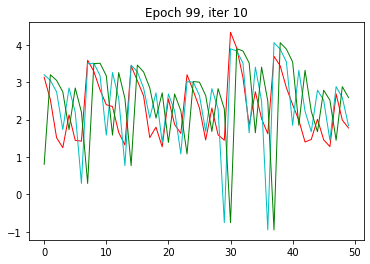

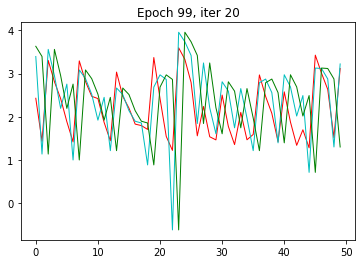

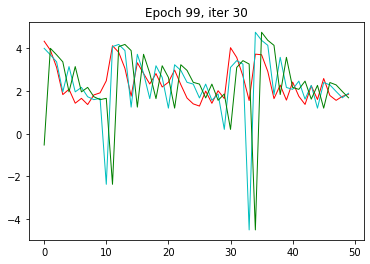

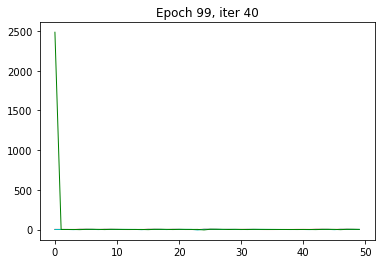

In [19]:
for epoch in range(n_epochs):
    for iter in range(n_iters):
        _inputs, _targets = sample_from_table(n_sample_size, source_data)

        inputs = Variable(torch.from_numpy(np.array([_inputs[0:10],
                                                    _inputs[10:20],
                                                    _inputs[20:30],
                                                    _inputs[30:40],
                                                    _inputs[40:50]],
                                                    dtype = np.double)).unsqueeze(2))

        targets = Variable(torch.from_numpy(np.array([_targets[0:10],
                                                    _targets[10:20],
                                                    _targets[20:30],
                                                    _targets[30:40],
                                                    _targets[40:50]],
                                                    dtype = np.double)).unsqueeze(2).float())  # [49] 

        # print('Inputs {}, targets {}'.format(inputs.shape, targets.shape))

        # Use teacher forcing 50% of the time
        # force = random.random() < 0.5
        outputs, hidden = rnn_model(inputs.double(), None)

        optimizer.zero_grad()
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()

        losses[epoch] += loss

        if iter % 10 ==0:
            plt.clf()
            plt.ion()
            plt.title('Epoch {}, iter {}'.format(epoch, iter))
            plt.plot(torch.flatten(outputs.detach()), 'r-', linewidth = 1, label = 'Output')
            plt.plot(torch.flatten(targets), 'c-', linewidth = 1, label = 'Label')
            plt.plot(torch.flatten(inputs), 'g-', linewidth = 1, label = 'Input')
            plt.draw()
            plt.pause(0.05)

# if epoch > 0:
#     print(epoch, loss)

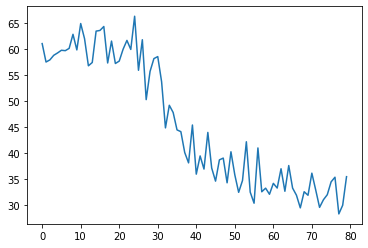

In [20]:
plt.plot(losses[20:])
plt.show()